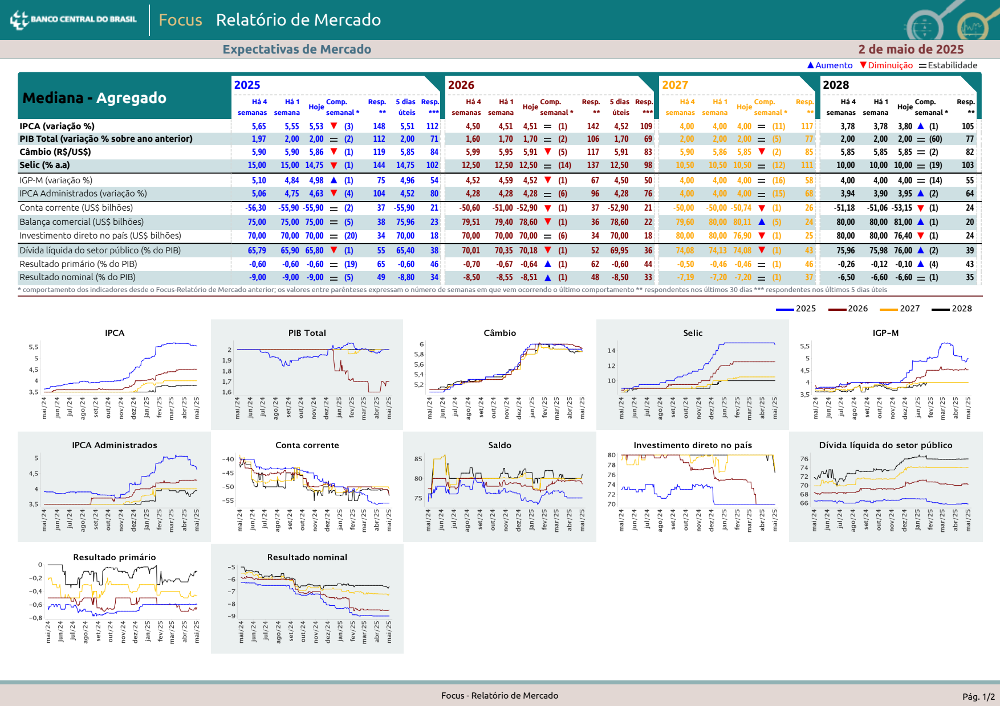

In [1]:
from natural_pdf import PDF

pdf = PDF("focus/focus.pdf")
page = pdf.pages[0]
page.show()

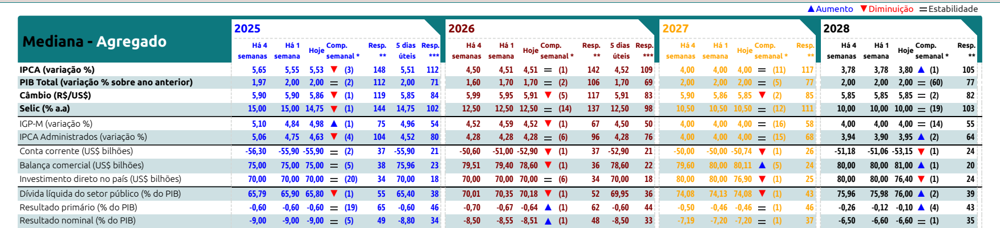

In [2]:
data = (
    page
    .find(text='Expectativas')
    .below(
        until='text:contains(comportamento)',
        include_endpoint=False
    )
)
    
data.show(crop=True)

In [3]:
row_names = (
    data
    .find(text='IPCA')
    .below(width='element', include_source=True)
    .clip(data)
    .find_all('text', overlap='partial')
)
headers = row_names.extract_each_text()
headers

['IPCA (variação %)',
 'PIB Total (variação % sobre ano anterior)',
 'Câmbio (R$/US$)',
 'Selic (% a.a)',
 'IGP-M (variação %)',
 'IPCA Administrados (variação %)',
 'Conta corrente (US$ bilhões)',
 'Balança comercial (US$ bilhões)',
 'Investimento direto no país (US$ bilhões)',
 'Dívida líquida do setor público (% do PIB)',
 'Resultado primário (% do PIB)',
 'Resultado nominal (% do PIB)']

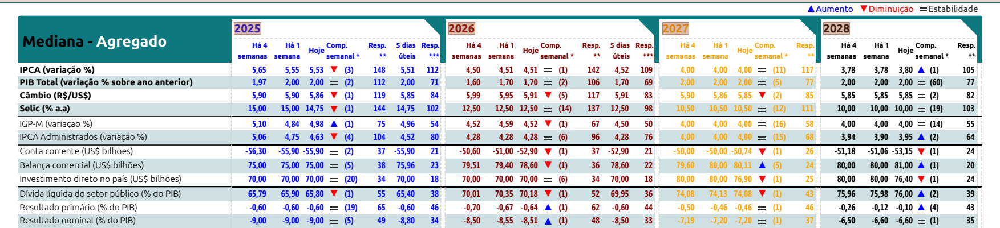

In [4]:
data.find_all("text[size~=10]:regex(\d\d\d\d)").show(crop=data)

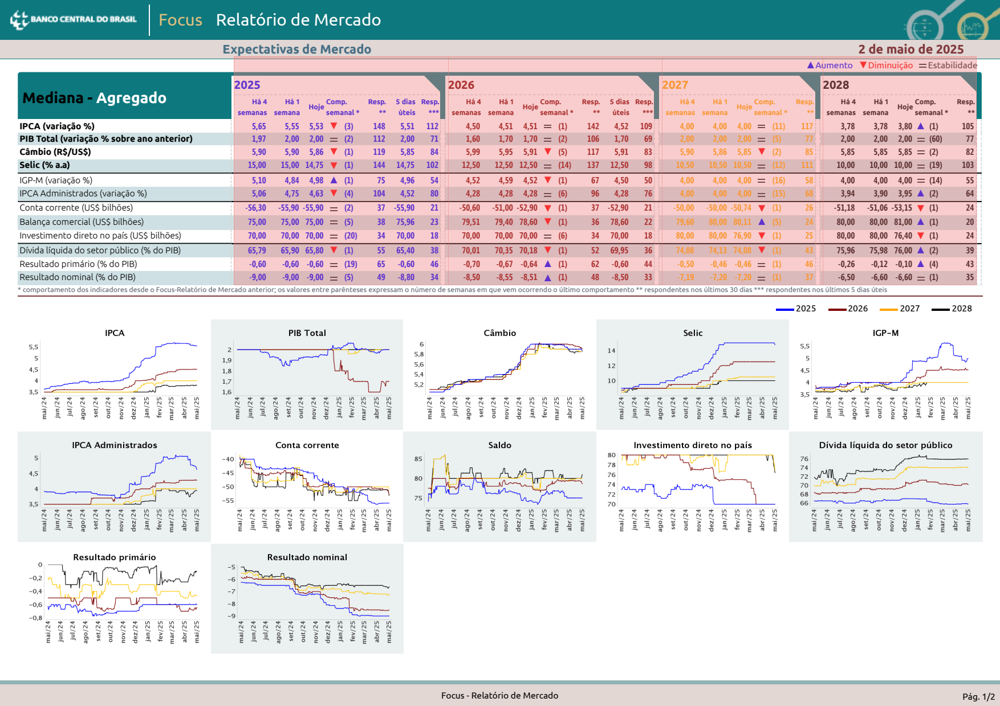

In [34]:
sections = (
    data.get_sections(
        start_elements="text[size~=10]:regex(\d\d\d\d)",
        include_boundaries='start',
        orientation='horizontal'
    )
)
sections.show()

In [36]:
dataframes = sections.apply(lambda section: (
    section
        .expand(top=-50, right=0)
        .extract_table('stream')
        .to_df(header=False)
        .dropna(axis=0, how='all')
        .assign(
            year=section.find('text[size~=10]:regex(\d\d\d\d)').extract_text(),
            value=headers
        )
    )
)

import pandas as pd

pd.concat(dataframes, ignore_index=True)

,0,1,2,3,4,5,6,7,year,value
0,"5,65","5,55","5,53",▼,(3),148,"5,51",112,2025,IPCA (variação %)
1,"1,97","2,00","2,00",<NA>,(2),112,"2,00",71,2025,PIB Total (variação % sobre ano anterior)
2,"5,90","5,90","5,86",▼,(1),119,"5,85",84,2025,Câmbio (R$/US$)
3,"15,00","15,00","14,75",▼,(1),144,"14,75",102,2025,Selic (% a.a)
4,"5,10","4,84","4,98",▲,(1),75,"4,96",54,2025,IGP-M (variação %)
5,"5,06","4,75","4,63",▼,(4),104,"4,52",80,2025,IPCA Administrados (variação %)
6,"-56,30","-55,90","-55,90",<NA>,(2),37,"-55,90",21,2025,Conta corrente (US$ bilhões)
7,"75,00","75,00","75,00",<NA>,(5),38,"75,96",23,2025,Balança comercial (US$ bilhões)
8,"70,00","70,00","70,00",<NA>,(20),34,"70,00",18,2025,Investimento direto no país (US$ bilhões)
9,"65,79","65,90","65,80",▼,(1),55,"65,40",38,2025,Dívida líquida do setor público (% do PIB)


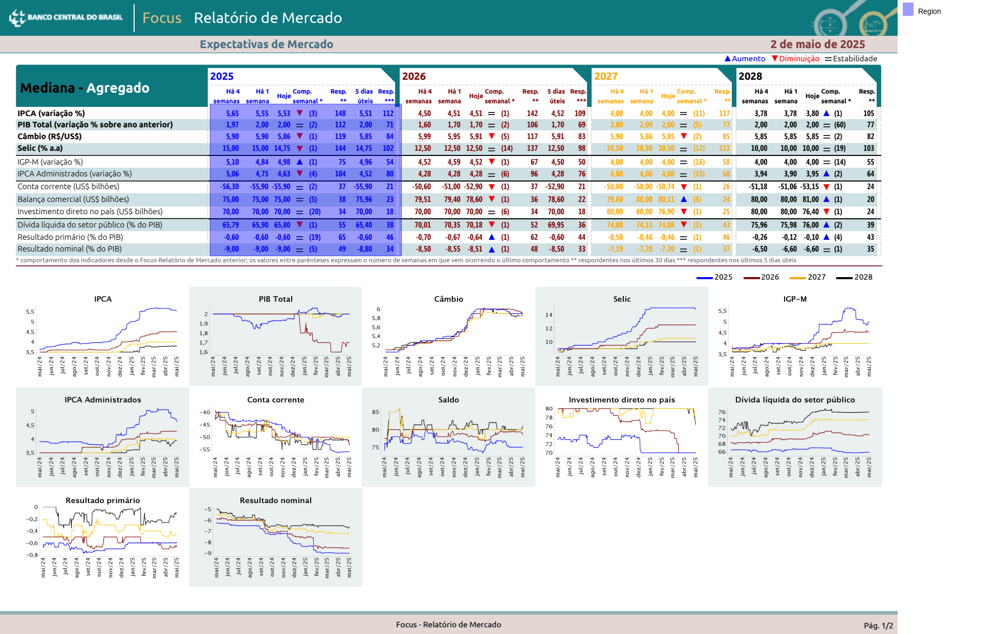

In [218]:
table = (
    data
    .find('text:contains(2025)')
    .right(
        until='text:contains(2026)',
        include_source=True,
        include_endpoint=False
    )
    .below(width='element')
    .expand(top=-20)
    .clip(data)
)
table_2025.show()

In [211]:
df_2025 = table.expand(top=-5).extract_table('stream').to_df(header=False).dropna(axis=0, how='all')
df_2025.insert(0, 'year', 2025)
df_2025.insert(0, 'value', headers)
df_2025

,value,year,0,1,2,3,4,5
0,IPCA (variação %),2025,"3,78","3,78","3,80",▲,(1),105
1,PIB Total (variação % sobre ano anterior),2025,"2,00","2,00","2,00",<NA>,(60),77
2,Câmbio (R$/US$),2025,"5,85","5,85","5,85",<NA>,(2),82
3,Selic (% a.a),2025,"10,00","10,00","10,00",<NA>,(19),103
5,IGP-M (variação %),2025,"4,00","4,00","4,00",<NA>,(14),55
6,IPCA Administrados (variação %),2025,"3,94","3,90","3,95",▲,(2),64
8,Conta corrente (US$ bilhões),2025,"-51,18","-51,06","-53,15",▼,(1),24
9,Balança comercial (US$ bilhões),2025,"80,00","80,00","81,00",▲,(1),20
10,Investimento direto no país (US$ bilhões),2025,"80,00","80,00","76,40",▼,(1),24
11,Dívida líquida do setor público (% do PIB),2025,"75,96","75,98","76,00",▲,(2),39


In [212]:
table = (
    data
    .find('text:contains(2026)')
    .right(
        until='text:contains(2027)',
        include_source=True,
        include_endpoint=False
    )
    .below(width='element')
    .expand(top=-20)
    .clip(data)
)
df_2026 = table.expand(top=-5).extract_table('stream').to_df(header=False).dropna(axis=0, how='all')
df_2026.insert(0, 'year', 2026)
df_2026.insert(0, 'value', headers)
df_2026

,value,year,0,1,2,3,4,5,6,7
0,IPCA (variação %),2026,"4,50","4,51","4,51",<NA>,(1),142,"4,52",109
1,PIB Total (variação % sobre ano anterior),2026,"1,60","1,70","1,70",<NA>,(2),106,"1,70",69
2,Câmbio (R$/US$),2026,"5,99","5,95","5,91",▼,(5),117,"5,91",83
3,Selic (% a.a),2026,"12,50","12,50","12,50",<NA>,(14),137,"12,50",98
5,IGP-M (variação %),2026,"4,52","4,59","4,52",▼,(1),67,"4,50",50
6,IPCA Administrados (variação %),2026,"4,28","4,28","4,28",<NA>,(6),96,"4,28",76
8,Conta corrente (US$ bilhões),2026,"-50,60","-51,00","-52,90",▼,(1),37,"-52,90",21
9,Balança comercial (US$ bilhões),2026,"79,51","79,40","78,60",▼,(1),36,"78,60",22
10,Investimento direto no país (US$ bilhões),2026,"70,00","70,00","70,00",<NA>,(6),34,"70,00",18
12,Dívida líquida do setor público (% do PIB),2026,"70,01","70,35","70,18",▼,(1),52,"69,95",36


In [209]:
table = (
    data
    .find('text:contains(2027)')
    .right(
        until='text:contains(2028)',
        include_source=True,
        include_endpoint=False
    )
    .below(width='element')
    .expand(top=-20)
    .clip(data)
)
df = table.expand(top=-5).extract_table('stream').to_df(header=False).dropna(axis=0, how='all')
df.insert(0, 'year', 2027)
df.insert(0, 'value', headers)
df

,value,0,1,2,3,4,5
0,IPCA (variação %),"4,00","4,00","4,00",<NA>,(11),117
1,PIB Total (variação % sobre ano anterior),"2,00","2,00","2,00",<NA>,(5),77
2,Câmbio (R$/US$),"5,90","5,86","5,85",▼,(2),85
3,Selic (% a.a),"10,50","10,50","10,50",<NA>,(12),111
5,IGP-M (variação %),"4,00","4,00","4,00",<NA>,(16),58
6,IPCA Administrados (variação %),"4,00","4,00","4,00",<NA>,(15),68
8,Conta corrente (US$ bilhões),"-50,00","-50,00","-50,74",▼,(1),26
9,Balança comercial (US$ bilhões),"79,60","80,00","80,11",▲,(5),24
10,Investimento direto no país (US$ bilhões),"80,00","80,00","76,90",▼,(1),25
11,Dívida líquida do setor público (% do PIB),"74,08","74,13","74,08",▼,(1),43


In [210]:
table = (
    data
    .find('text:contains(2028)')
    .right(include_source=True)
    .below(width='element')
    .expand(top=-20)
    .clip(data)
)
df = table.expand(top=-5).extract_table('stream').to_df(header=False).dropna(axis=0, how='all')
df.insert(0, 'year', 2028)
df.insert(0, 'value', headers)
df

,value,0,1,2,3,4,5
0,IPCA (variação %),"3,78","3,78","3,80",▲,(1),105
1,PIB Total (variação % sobre ano anterior),"2,00","2,00","2,00",<NA>,(60),77
2,Câmbio (R$/US$),"5,85","5,85","5,85",<NA>,(2),82
3,Selic (% a.a),"10,00","10,00","10,00",<NA>,(19),103
5,IGP-M (variação %),"4,00","4,00","4,00",<NA>,(14),55
6,IPCA Administrados (variação %),"3,94","3,90","3,95",▲,(2),64
8,Conta corrente (US$ bilhões),"-51,18","-51,06","-53,15",▼,(1),24
9,Balança comercial (US$ bilhões),"80,00","80,00","81,00",▲,(1),20
10,Investimento direto no país (US$ bilhões),"80,00","80,00","76,40",▼,(1),24
11,Dívida líquida do setor público (% do PIB),"75,96","75,98","76,00",▲,(2),39


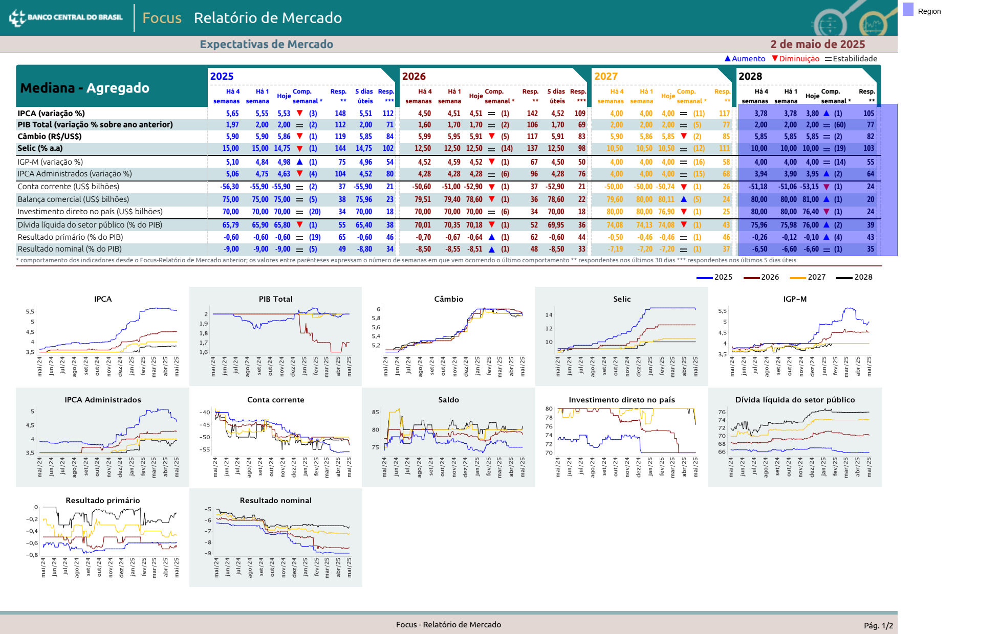

In [175]:
table.expand(top=0).show()

In [214]:
import pandas as pd

df = pd.concat([df_2025, df_2026, df])
df

,value,year,0,1,2,3,4,5,6,7
0,IPCA (variação %),2025.0,"3,78","3,78","3,80",▲,(1),105,NaN,NaN
1,PIB Total (variação % sobre ano anterior),2025.0,"2,00","2,00","2,00",<NA>,(60),77,NaN,NaN
2,Câmbio (R$/US$),2025.0,"5,85","5,85","5,85",<NA>,(2),82,NaN,NaN
3,Selic (% a.a),2025.0,"10,00","10,00","10,00",<NA>,(19),103,NaN,NaN
5,IGP-M (variação %),2025.0,"4,00","4,00","4,00",<NA>,(14),55,NaN,NaN
6,IPCA Administrados (variação %),2025.0,"3,94","3,90","3,95",▲,(2),64,NaN,NaN
8,Conta corrente (US$ bilhões),2025.0,"-51,18","-51,06","-53,15",▼,(1),24,NaN,NaN
9,Balança comercial (US$ bilhões),2025.0,"80,00","80,00","81,00",▲,(1),20,NaN,NaN
10,Investimento direto no país (US$ bilhões),2025.0,"80,00","80,00","76,40",▼,(1),24,NaN,NaN
11,Dívida líquida do setor público (% do PIB),2025.0,"75,96","75,98","76,00",▲,(2),39,NaN,NaN


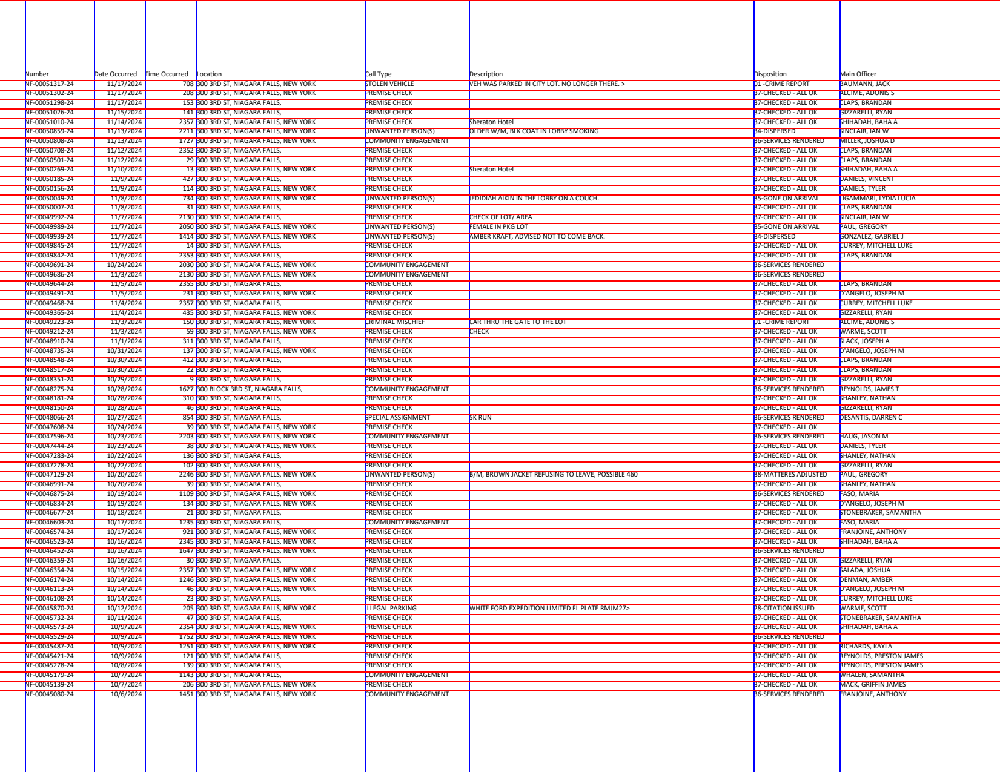

In [115]:
from natural_pdf import PDF

pdf = PDF("24480polcompleted/24480polcompleted.pdf")
pages = pdf.pages[4:]
pages[-1].add_exclusion('text:regex(\\d+ Records Found)')
from natural_pdf.analyzers.guides import Guides

guide = Guides(pages[0])
columns = ['Number', 'Date Occurred', 'Time Occurred', 'Location', 'Call Type', 'Description', 'Disposition', 'Main Officer']
guide.vertical.from_content(columns, outer="last")
guide.horizontal.from_content(lambda p: p.find_all('text:starts-with(NF-)'))
guide.show()


In [116]:
table_result = guide.extract_table(pages, header="first")
df = table_result.to_df()
df.head()


TypeError: Guides.extract_table() got an unexpected keyword argument 'header'

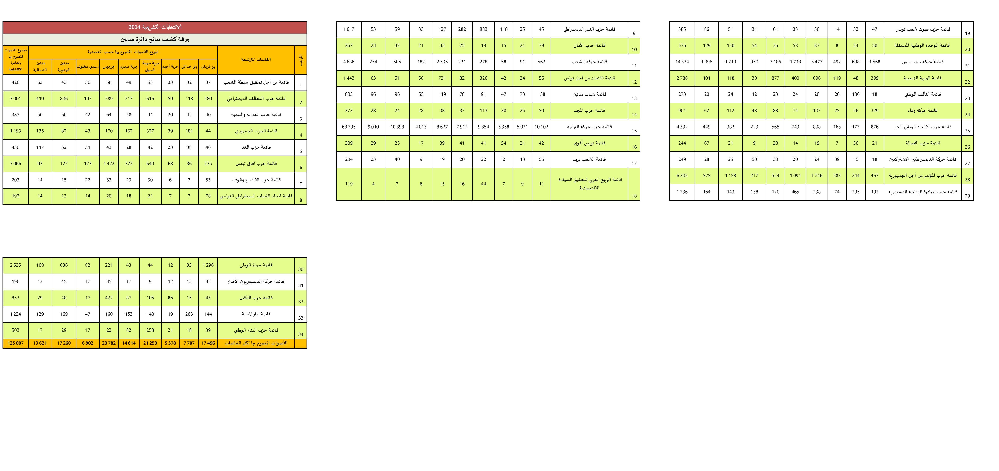

In [24]:
from natural_pdf import PDF

pdf = PDF("mednine/mednine.pdf")
pdf.show(cols=3)

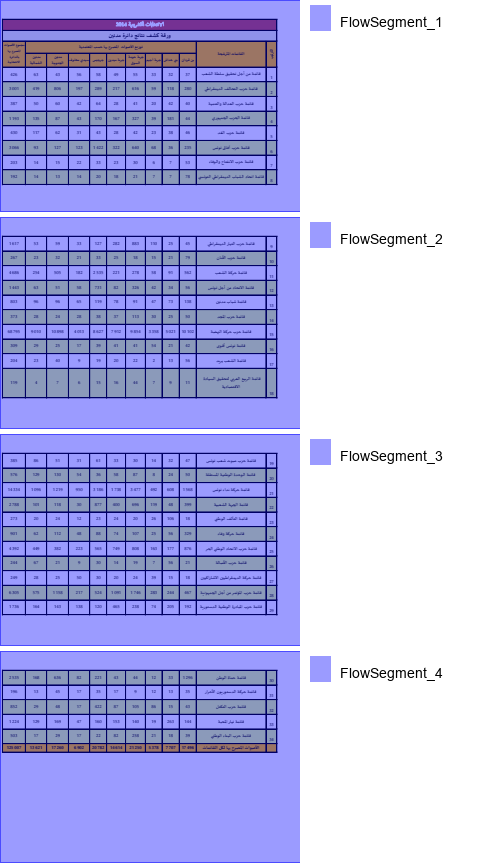

In [110]:
from natural_pdf.flows import Flow

flow = Flow(pdf.pages, arrangement='vertical')
flow.show(width=300)

In [112]:
df = flow.extract_table().to_df(header=None)
df

,0,1,2,3,4,5,6,7,8,9,10,11
0,الانتخاابت الترشيعية 2014,None,None,None,None,None,None,None,None,None,None,None
1,ورقة كشف نتائج دائرة مدنين,None,None,None,None,None,None,None,None,None,None,None
2,مجموع األصوات\nاملصرح بها\nبالدائرة\nاالنتخابية,توزيع األصوات املصرح بها حسب املعتمدية,None,None,None,None,None,None,None,None,القائمات املترشحة,ا\nل\nرت\nت\nي\nب
3,None,مدنين\nالشمالية,مدنين\nالجنوبية,سيدي مخلوف,جرجيس,جربة ميدون,جربة حومة\nالسوق,جربة أجيم,بني خداش,بن قردان,None,None
4,426,63,43,56,58,49,55,33,32,37,قائمة من أجل تحقيق سلطة الشعب,1
5,3 001,419,806,197,289,217,616,59,118,280,قائمة حزب التحالف الديمقراطي,2
6,387,50,60,42,64,28,41,20,42,40,قائمة حزب العدالة والتنمية,3
7,1 193,135,87,43,170,167,327,39,181,44,قائمة الحزب الجمهوري,4
8,430,117,62,31,43,28,42,23,38,46,قائمة حزب الغد,5
9,3 066,93,127,123,1 422,322,640,68,36,235,قائمة حزب آفاق تونس,6


In [108]:
dataframes = pdf.pages.apply(lambda page: (
    page.extract_table().to_df(header=None)
    )
)
print("Found", len(dataframes), "tables")

# Combine
df = pd.concat(dataframes, ignore_index=True)
df

Found 4 tables


,0,1,2,3,4,5,6,7,8,9,10,11
0,الانتخاابت الترشيعية 2014,None,None,None,None,None,None,None,None,None,None,None
1,ورقة كشف نتائج دائرة مدنين,None,None,None,None,None,None,None,None,None,None,None
2,مجموع األصوات\nاملصرح بها\nبالدائرة\nاالنتخابية,توزيع األصوات املصرح بها حسب املعتمدية,None,None,None,None,None,None,None,None,القائمات املترشحة,ا\nل\nرت\nت\nي\nب
3,None,مدنين\nالشمالية,مدنين\nالجنوبية,سيدي مخلوف,جرجيس,جربة ميدون,جربة حومة\nالسوق,جربة أجيم,بني خداش,بن قردان,None,None
4,426,63,43,56,58,49,55,33,32,37,قائمة من أجل تحقيق سلطة الشعب,1
5,3 001,419,806,197,289,217,616,59,118,280,قائمة حزب التحالف الديمقراطي,2
6,387,50,60,42,64,28,41,20,42,40,قائمة حزب العدالة والتنمية,3
7,1 193,135,87,43,170,167,327,39,181,44,قائمة الحزب الجمهوري,4
8,430,117,62,31,43,28,42,23,38,46,قائمة حزب الغد,5
9,3 066,93,127,123,1 422,322,640,68,36,235,قائمة حزب آفاق تونس,6


In [113]:
# Use row 2 as header
df.columns = df.iloc[3].fillna(df.iloc[2]).str.replace("\n", " ")

# Drop the first 3 rows
df = df.iloc[4:].reset_index(drop=True)

# Remove spaces from numbers and convert to int
numeric_cols = df.columns[0:4]
df[numeric_cols] = df[numeric_cols].replace(r"\s+", "", regex=True).astype(int)
df

3,مجموع األصوات املصرح بها بالدائرة االنتخابية,مدنين الشمالية,مدنين الجنوبية,سيدي مخلوف,جرجيس,جربة ميدون,جربة حومة السوق,جربة أجيم,بني خداش,بن قردان,القائمات املترشحة,ا ل رت ت ي ب
0,426,63,43,56,58,49,55,33,32,37,قائمة من أجل تحقيق سلطة الشعب,1
1,3001,419,806,197,289,217,616,59,118,280,قائمة حزب التحالف الديمقراطي,2
2,387,50,60,42,64,28,41,20,42,40,قائمة حزب العدالة والتنمية,3
3,1193,135,87,43,170,167,327,39,181,44,قائمة الحزب الجمهوري,4
4,430,117,62,31,43,28,42,23,38,46,قائمة حزب الغد,5
5,3066,93,127,123,1 422,322,640,68,36,235,قائمة حزب آفاق تونس,6
6,203,14,15,22,33,23,30,6,7,53,قائمة حزب االنفتاح والوفاء,7
7,192,14,13,14,20,18,21,7,7,78,قائمة اتحاد الشباب الديمقراطي التونس ي,8
8,1617,53,59,33,127,282,883,110,25,45,قائمة حزب التيار الديمقراطي,9
9,267,23,32,21,33,25,18,15,21,79,قائمة حزب األمان,10


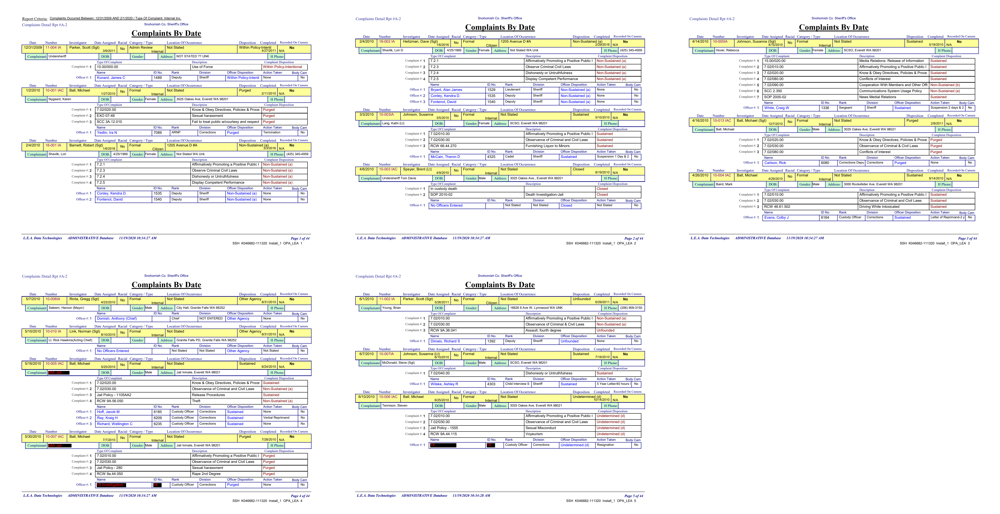

In [1]:
from natural_pdf import PDF

pdf = PDF("k046682-111320-opa-lea-database-install_1/k046682-111320-opa-lea-database-install_1.pdf")
pdf.show(cols=3)

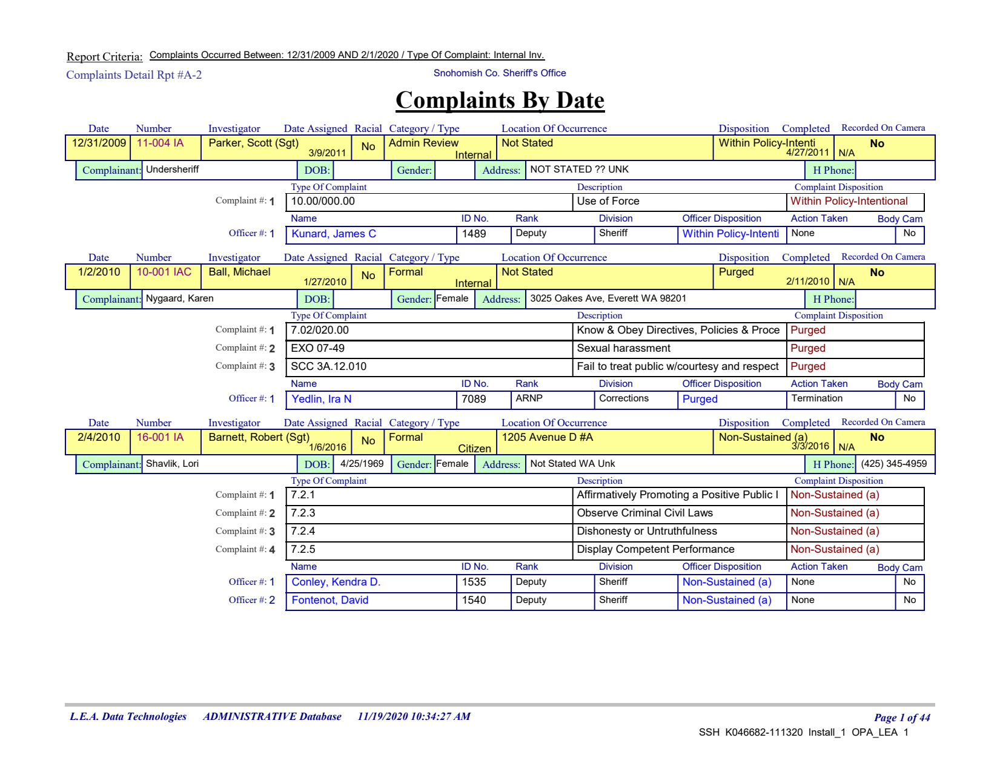

In [2]:
page = pdf.pages[0]
page.show()

In [3]:
pdf.add_exclusion(lambda page: page.find(text='L.E.A. Data Technologies').below(include_source=True))
pdf.add_exclusion(lambda page: page.find(text='Complaints By Date').above(include_source=True))

<PDF source='k046682-111320-opa-lea-database-install_1/k046682-111320-opa-lea-database-install_1.pdf' pages=5>

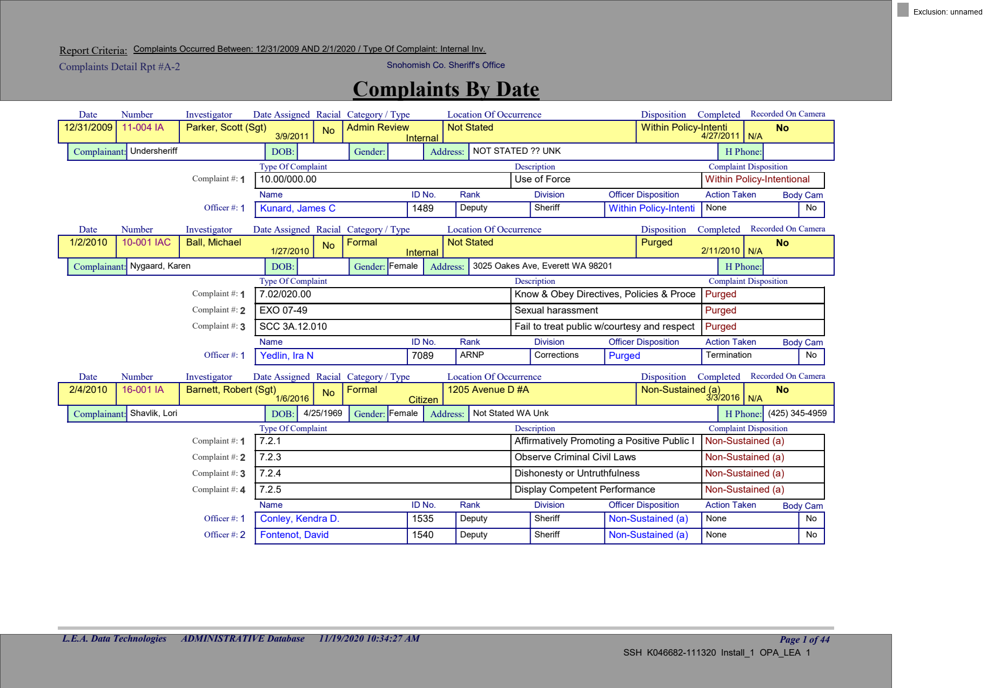

In [4]:
page.show(exclusions='black')

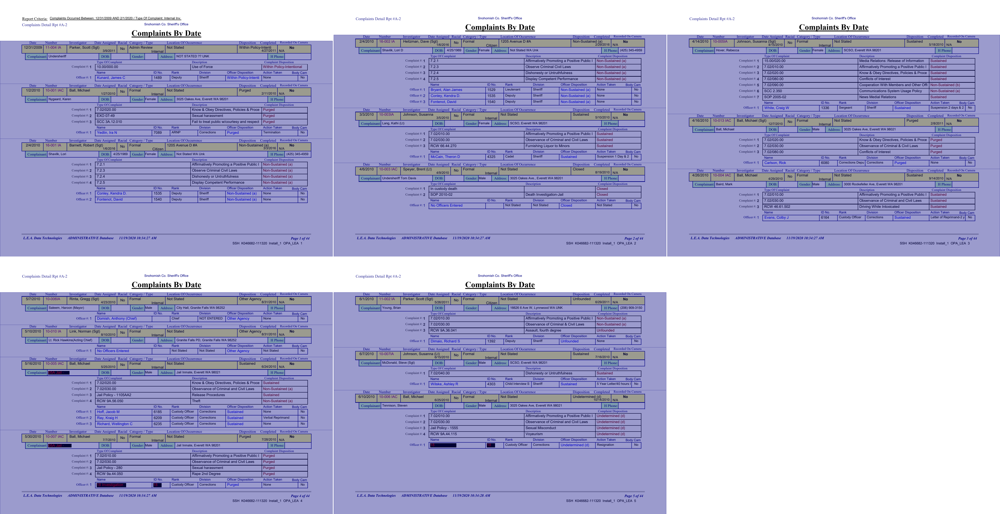

In [5]:
sections = pdf.get_sections('text:contains(Recorded)', include_boundaries='start')
sections.show(cols=3)

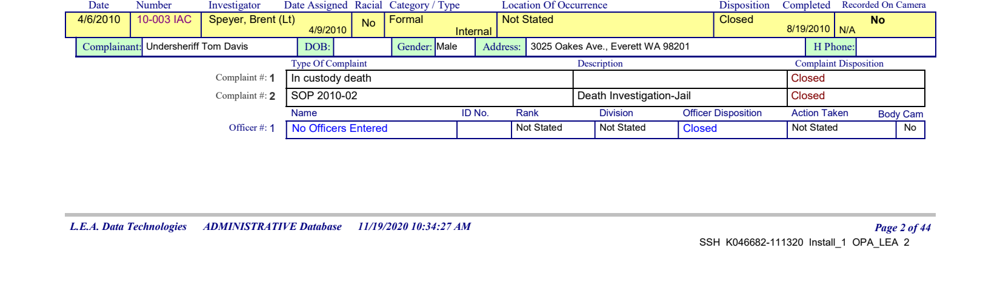

In [7]:
section = sections[5]
section.show(crop=True)

In [12]:
from natural_pdf.analyzers.guides import Guides

table = (
    section
    .find_all('text:contains(Complaint #)')
    .right(include_source=True)
    .merge()
    .expand(top=5, bottom=7)
)

guides = Guides(table)
guides.vertical.from_lines(n=4)

table.extract_table(verticals=guides.vertical).to_df(header=None)

,0,1,2
0,In custody death,<NA>,Closed
1,SOP 2010-02,Death Investigation-Jail,Closed


In [22]:
date_assigned = section.find('text:contains(Date Assigned)').below(width='element').find('text')
date_assigned

<TextElement text='4/9/2010' font='F2 (F2)', variant='CIDFont' size=7.667711962741066 bbox=(244.60119880913737, 408.5225761945318, 274.4746046159765, 416.19028815727285)>

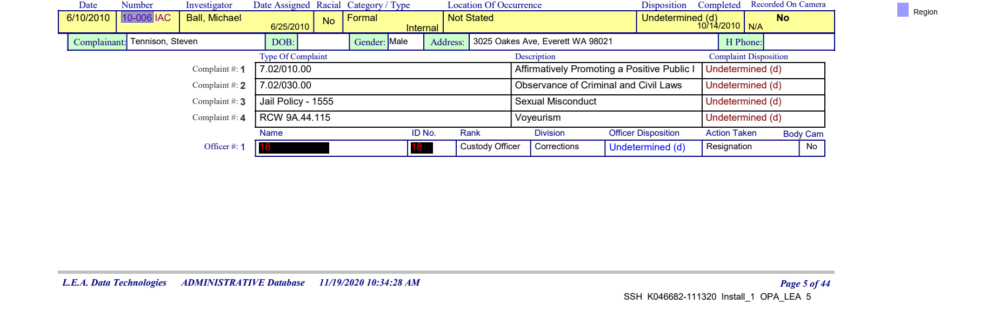

In [51]:
number = (
    section
        .find("text:contains(Number)")
        .below(until='text', width='element')
        # .find('text', overlap='partial')
)
number.show(crop=section)

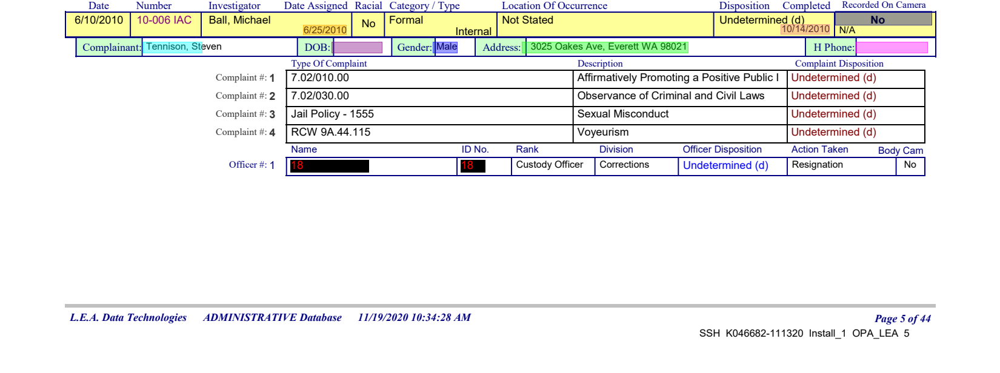

In [36]:
complainant = section.find("text:contains(Complainant)").right(until='text')
dob = section.find("text:contains(DOB)").right(until='text')
address = section.find("text:contains(Address)").right(until='text')
gender = section.find("text:contains(Gender)").right(until='text')
phone = section.find("text:contains(H Phone)").right(until='text')
date_assigned = section.find('text:contains(Date Assigned)').below(width='element').expand(left=5, right=5).find('text')
completed = section.find('text:contains(Completed)').below(width='element').expand(left=5, right=5).find('text')
recorded = section.find('text:contains(Recorded)').expand(left=5, right=5).below(until='text', width='element')

(complainant + dob + address + gender + phone + date_assigned + completed + recorded).show(crop=section)

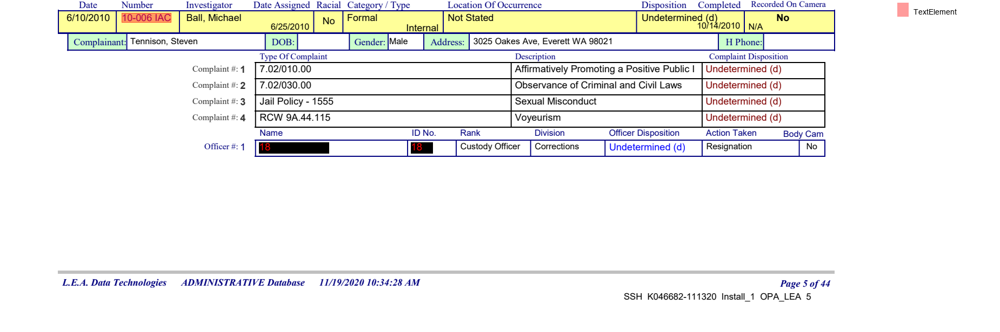

In [46]:
number = section.find("text:contains(Number)").below(until='text', width='element').find('text', overlap='partial')

(number).show(crop=section)

In [18]:
(
    section
    .find_all('text:contains(Complaint #)')
    .right(include_source=True)
    .merge()
    .expand(top=5, bottom=7)
    .extract_table()
    .to_df(header=['Type of Complaint', 'Description', 'Complaint Disposition'])
)

,Type of Complaint,Description,Complaint Disposition
0,In custody death,<NA>,Closed
1,SOP 2010-02,Death Investigation-Jail,Closed


In [19]:
(
    section
    .find_all('text:contains(Officer #)')
    .right(include_source=True)
    .merge()
    .expand(top=5, bottom=7)
    .extract_table()
    .to_df(header=['Name', 'ID No.', 'Rank', 'Division', 'Officer Disposition', 'Action Taken', 'Body Cam'])
)

,Name,ID No.,Rank,Division,Officer Disposition,Action Taken,Body Cam
0,No Officers Entered,<NA>,Not Stated,Not Stated,Closed,Not Stated,No


In [52]:
rows = []
for section in sections:
    complainant = section.find("text:contains(Complainant)").right(until='text')
    dob = section.find("text:contains(DOB)").right(until='text')
    address = section.find("text:contains(Address)").right(until='text')
    gender = section.find("text:contains(Gender)").right(until='text')
    phone = section.find("text:contains(H Phone)").right(until='text')
    investigator = (
        section
            .find("text:contains(Investigator)")
            .below(until='text', width='element')
            .find('text', overlap='partial')
    )
    number = (
        section
            .find("text:contains(Number)")
            .below(until='text', width='element')
            .find('text', overlap='partial')
    )
    date_assigned = (
      section
      .find('text:contains(Date Assigned)')
      .below(width='element')
      .expand(left=5, right=5)
      .find('text')
    )
    completed = (
      section
      .find('text:contains(Completed)')
      .below(width='element')
      .expand(left=5, right=5)
      .find('text')
    )
    recorded = (
      section
      .find('text:contains(Recorded)')
      .below(until='text', width='element')
      .expand(left=5, right=5)
    )
    
    row = {}
    row['complainant'] = complainant.extract_text()
    row['investigator'] = investigator.extract_text()
    row['number'] = number.extract_text()
    row['dob'] = dob.extract_text()
    row['address'] = address.extract_text()
    row['gender'] = gender.extract_text()
    row['phone'] = phone.extract_text()
    row['date_assigned'] = date_assigned.extract_text()
    row['completed'] = completed.extract_text()
    row['recorded'] = recorded.extract_text()
    rows.append(row)

print("We found", len(rows), "rows")

We found 16 rows


In [53]:
import pandas as pd

df = pd.DataFrame(rows)
df

,complainant,investigator,number,dob,address,gender,phone,date_assigned,completed,recorded
0,Undersheriff,"Parker, Scott (Sgt)",11-004 IA,,NOT STATED ?? UNK,,,3/9/2011,4/27/2011,No\nN/A
1,"Nygaard, Ka","Ball, Michael",10-001 IAC,,"3025 Oakes Ave, Evere",Female,,1/27/2010,2/11/2010,No\nN/A
2,"Shavlik, Lori","Barnett, Robert (Sgt)",16-001 IA,4/25/1969,Not Stated WA Unk,Female,(425) 345-4959,1/6/2016,3/3/2016,No\nN/A
3,"Shavlik, Lori D","Heitzman, Dave (Sgt)",16-002 IA,4/25/1969,Not Stated WA Unk,Female,(425) 345-4959,1/6/2016,2/29/2016,No\nN/A
4,"Lang, Kathi (Lt","Johnson, Susanna",10-003IA,,"SCSO, Everett WA",Female,,3/5/2010,5/10/2010,No\nN/A
5,Undersheriff To,"Speyer, Brent (Lt)",10-003 IAC,,"3025 Oakes Ave., E",Male,,4/9/2010,8/19/2010,No\nN/A
6,"Hover, Rebecca","Johnson, Susanna (Sgt)",10-005IA,,"SCSO, Everett WA 98201",Female,,4/15/2010,5/18/2010,No\nN/A
7,"Ball, Michael","Ball, Michael (Sgt)",10-013 IAC,,"3025 Oakes Ave, Everett W",Male,,12/7/2010,2/8/2011,No\nN/A
8,"Baird, Mark","Ball, Michael",10-004 IAC,,"3000 Rockefeller Ave, Eve",Male,,4/29/2010,9/14/2010,No\nN/A
9,"Saleem, Ha","Rinta, Gregg (Sgt)",10-006IA,,"City Hall, Granite Falls WA 98252",Male,,4/23/2010,8/31/2010,No\nN/A


In [23]:
import pandas as pd

officer_dfs = []
for section in sections:
    # Not every section has officers
    if 'Officer #' not in section.extract_text():
      continue

    case_number = (
        section
        .find("text:contains(Number)")
        .below(until='text', width='element')
        .find('text', overlap='partial')
        .extract_text()
    )

    table = (
      section
      .find_all('text:contains(Officer #)')
      .right(include_source=True)
      .merge()
      .expand(top=3, bottom=6)
    )
    
    guides = Guides(table)
    guides.vertical.from_lines(n=8)
    columns = ['Name', 'ID No.', 'Rank', 'Division', 'Officer Disposition', 'Action Taken', 'Body Cam']
    officer_df = table.extract_table(
      verticals=guides.vertical
    ).to_df(header=columns)
    officer_df['case_number'] = case_number
    officer_dfs.append(officer_df)

print("Combining", len(officer_dfs), "officer dataframes")
df = pd.concat(officer_dfs, ignore_index=True)
df.head()


Combining 16 officer dataframes


,Name,ID No.,Rank,Division,Officer Disposition,Action Taken,Body Cam,case_number
0,"Kunard, James C",1489,Deputy,Sheriff,Within Policy-Intenti,None,No,11-004 IA
1,"Yedlin, Ira N",7089,ARNP,Corrections,Purged,Termination,No,10-001 IAC
2,"Conley, Kendra D.",1535,Deputy,Sheriff,Non-Sustained (a),None,No,16-001 IA
3,"Fontenot, David",1540,Deputy,Sheriff,Non-Sustained (a),None,No,16-001 IA
4,"Bryant, Alan James",1529,Lieutenant,Sheriff,Non-Sustained (a),None,No,16-002 IA


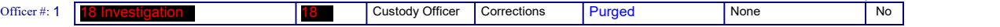

In [128]:
table.show(crop=True)

In [130]:
table.extract_table().to_df(header=None)

,0,1,2,3,4,5,6,7,8
0,18 Investigation,<NA>,18,<NA>,Custody Officer,Corrections,Purged,None,No


In [13]:
from natural_pdf.analyzers.guides import Guides

table = (
    section
    .find_all('text:contains(Officer #)')
    .right(include_source=True)
    .merge()
    .expand(top=3, bottom=6)
)

guides = Guides(table)
guides.vertical.from_lines(n=8)

table.extract_table(verticals=guides.vertical)

TableResult(rows=1)

In [98]:
(
    section
    .find_all('text:contains(Officer #)')
    .right()
    .expand(left=-10)
    # .show()
    .find_all('text', overlap='partial')
    .extract_each_text()
)

['No',
 'Custody Officer',
 'Corrections',
 'None',
 '18 Investigation',
 '18',
 'Purged']

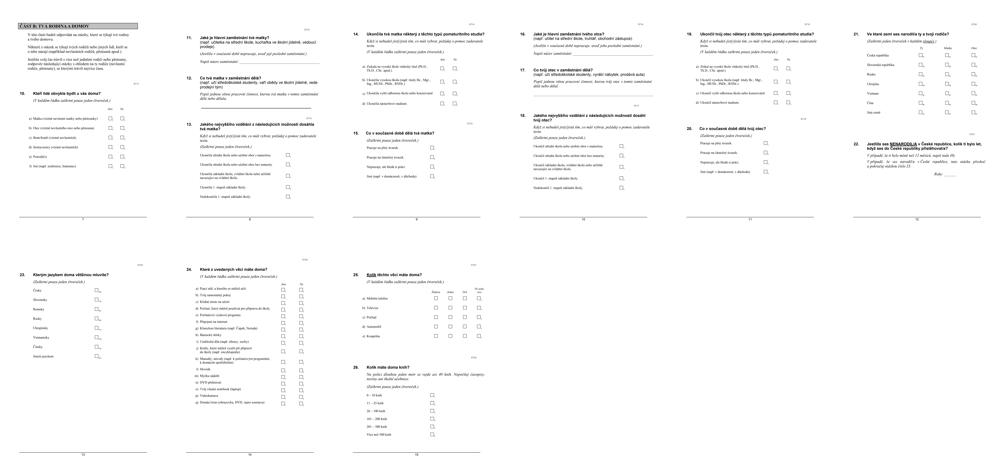

In [1]:
from natural_pdf import PDF

pdf = PDF("czech-republic-pisa2012_zakovsky_dotaznik_a/czech-republic-pisa2012_zakovsky_dotaznik_a.pdf")
pdf.pages[6:15].show()

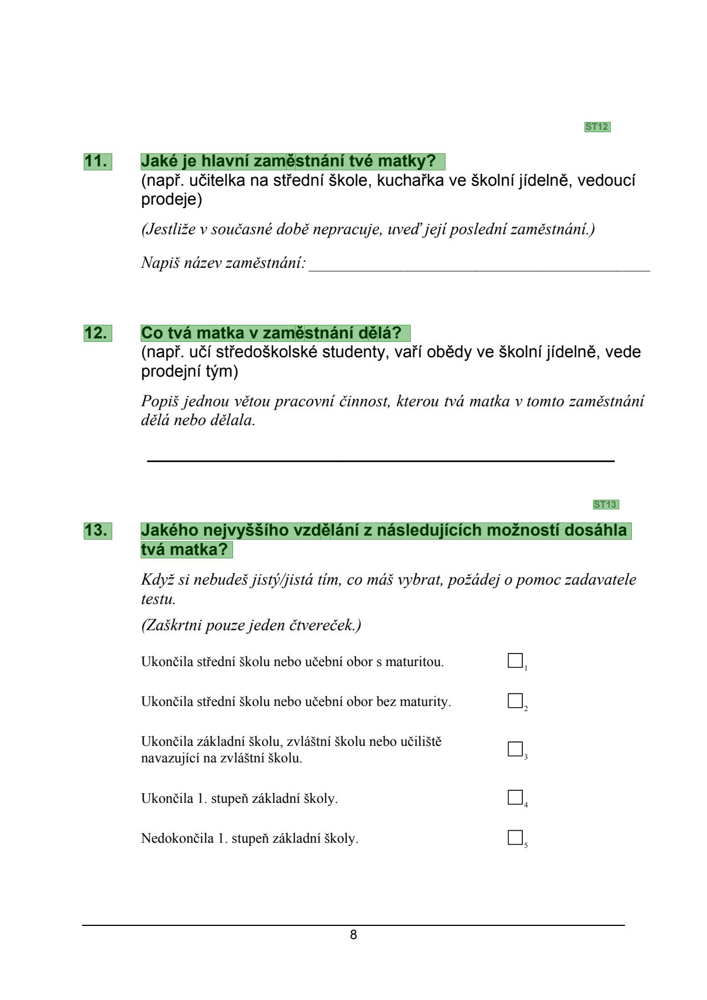

In [2]:
pdf.pages[7].find_all("text:bold:not-empty").show()

In [3]:
pdf.pages[7].inspect()

text,x0,top,x1,bottom,font_family,font_variant,size,bold,italic,strike,underline,highlight,source,confidence,color
,71,73,74,87,Times,EPFLBH,14,True,True,False,False,True,native,1.00,#007f00
ST12,493,103,514,111,Arial,BCOMPD,8,True,False,False,False,True,native,1.00,#7f7f7f
,71,104,75,118,Arial,BCOMPD,14,True,False,False,False,True,native,1.00,#000000
11.,71,129,94,143,Arial,BCOMPD,14,True,False,False,False,True,native,1.00,#000000
Jaké je hlavní zam,119,129,241,143,Arial,BCOMPD,14,True,False,False,False,True,native,1.00,#000000
ě,241,129,249,143,Arial,BCOMPC,14,True,False,False,False,True,native,1.00,#000000
stnání tvé matky?,249,129,375,143,Arial,BCOMPD,14,True,False,False,False,True,native,1.00,#000000
(nap,119,145,147,159,Arial,EPFLAG,14,False,False,False,False,True,native,1.00,#000000
ř,147,145,152,159,Arial,EPFKOG,14,False,False,False,False,True,native,1.00,#000000
. u,152,145,167,159,Arial,EPFLAG,14,False,False,False,False,True,native,1.00,#000000


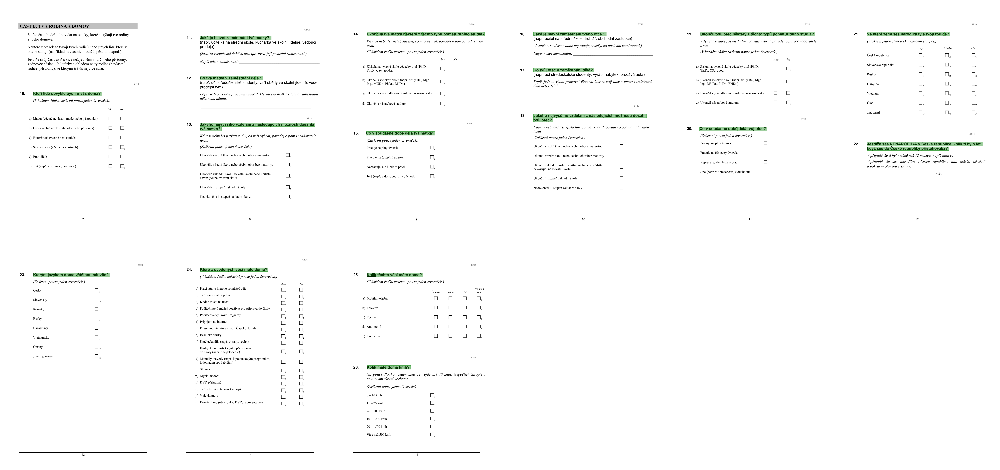

In [4]:
(
    pdf
    .pages[6:15]
    .find_all('text:bold[size~=14][x0>100]:not-empty')
    .show()
)

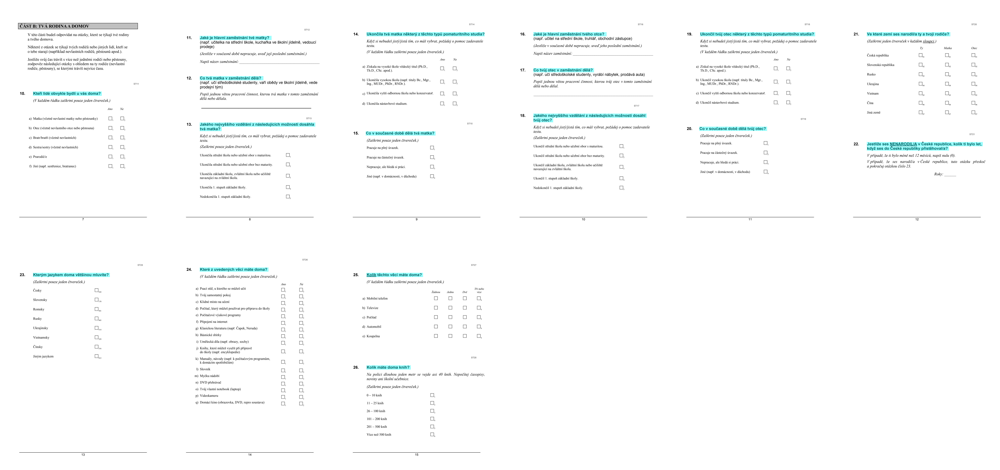

In [5]:
(
    pdf
    .pages[6:15]
    .find_all('text:bold[size~=14][x0>100]:not-empty')
    .dissolve(padding=0)
    .show()
)

In [6]:
pdf.pages[7].inspect()

text,x0,top,x1,bottom,font_family,font_variant,size,bold,italic,strike,underline,highlight,source,confidence,color
,71,73,74,87,Times,EPFLBH,14,True,True,False,False,True,native,1.00,#007f00
ST12,493,103,514,111,Arial,BCOMPD,8,True,False,False,False,True,native,1.00,#7f7f7f
,71,104,75,118,Arial,BCOMPD,14,True,False,False,False,True,native,1.00,#000000
11.,71,129,94,143,Arial,BCOMPD,14,True,False,False,False,True,native,1.00,#000000
Jaké je hlavní zam,119,129,241,143,Arial,BCOMPD,14,True,False,False,False,True,native,1.00,#000000
ě,241,129,249,143,Arial,BCOMPC,14,True,False,False,False,True,native,1.00,#000000
stnání tvé matky?,249,129,375,143,Arial,BCOMPD,14,True,False,False,False,True,native,1.00,#000000
(nap,119,145,147,159,Arial,EPFLAG,14,False,False,False,False,True,native,1.00,#000000
ř,147,145,152,159,Arial,EPFKOG,14,False,False,False,False,True,native,1.00,#000000
. u,152,145,167,159,Arial,EPFLAG,14,False,False,False,False,True,native,1.00,#000000


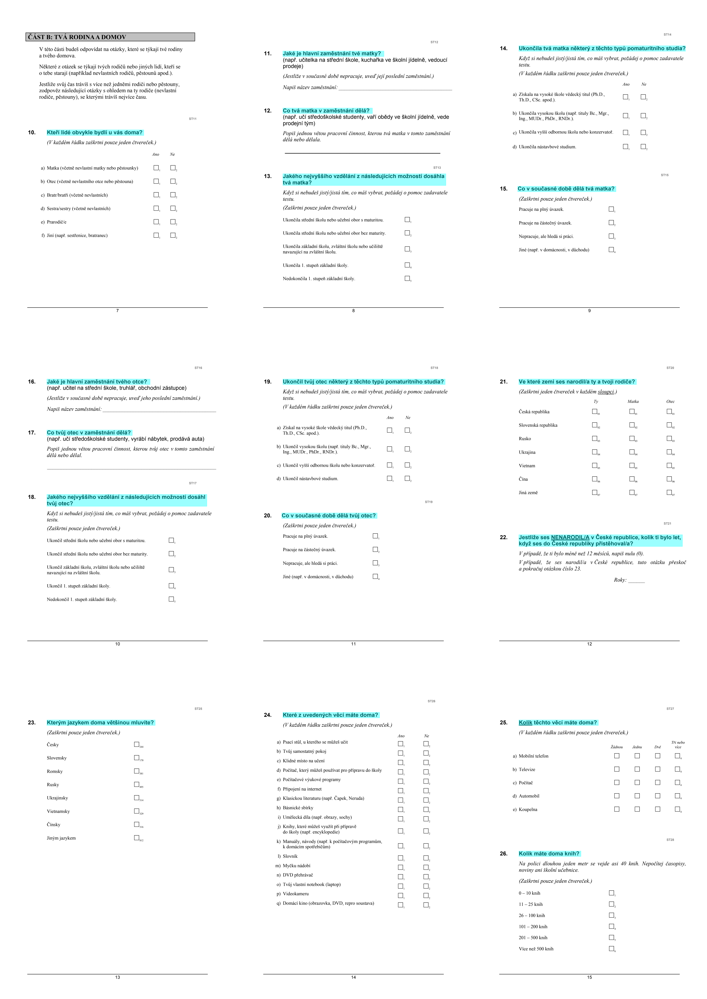

In [103]:
questions = (
    pdf
    .pages[6:15]
    .find_all('text:bold[size~=14][x0>100]:not-empty')
    .dissolve(padding=5)
)
questions.show(cols=3)

In [104]:
questions.extract_each_text()

['Kteří lidé obvykle bydlí u vás doma?',
 'Jaké je hlavní zaměstnání tvé matky?',
 'Co tvá matka v zaměstnání dělá?',
 'Jakého nejvyššího vzdělání z následujících možností dosáhla\ntvá matka?',
 'Ukončila tvá matka některý z těchto typů pomaturitního studia?',
 'Co v současné době dělá tvá matka?',
 'Jaké je hlavní zaměstnání tvého otce?',
 'Co tvůj otec v zaměstnání dělá?',
 'Jakého nejvyššího vzdělání z následujících možností dosáhl\ntvůj otec?',
 'Ukončil tvůj otec některý z těchto typů pomaturitního studia?',
 'Co v současné době dělá tvůj otec?',
 'Ve které zemi ses narodil/a ty a tvoji rodiče?',
 'Jestliže ses NENARODIL/A v České republice, kolik ti bylo let,\nkdyž ses do České republiky přistěhoval/a?',
 'Kterým jazykem doma většinou mluvíte?',
 'Které z uvedených věcí máte doma?',
 'Kolik těchto věcí máte doma?',
 'Kolik máte doma knih?']

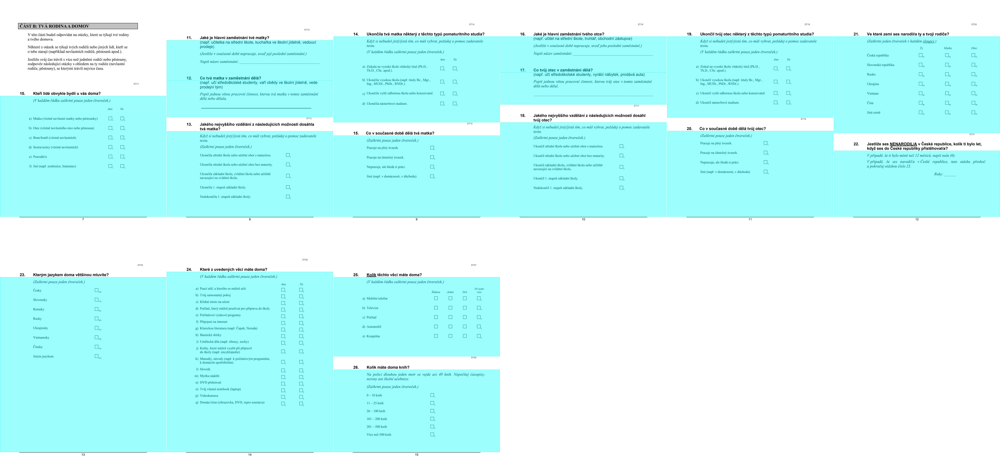

In [105]:
answer_areas = (
    questions.below(
        until='text:bold[size~=14]:regex(\d+) | rect[width>300] | text:regex(^ST\d)',
        include_endpoint=False
    )
)
answer_areas.show()

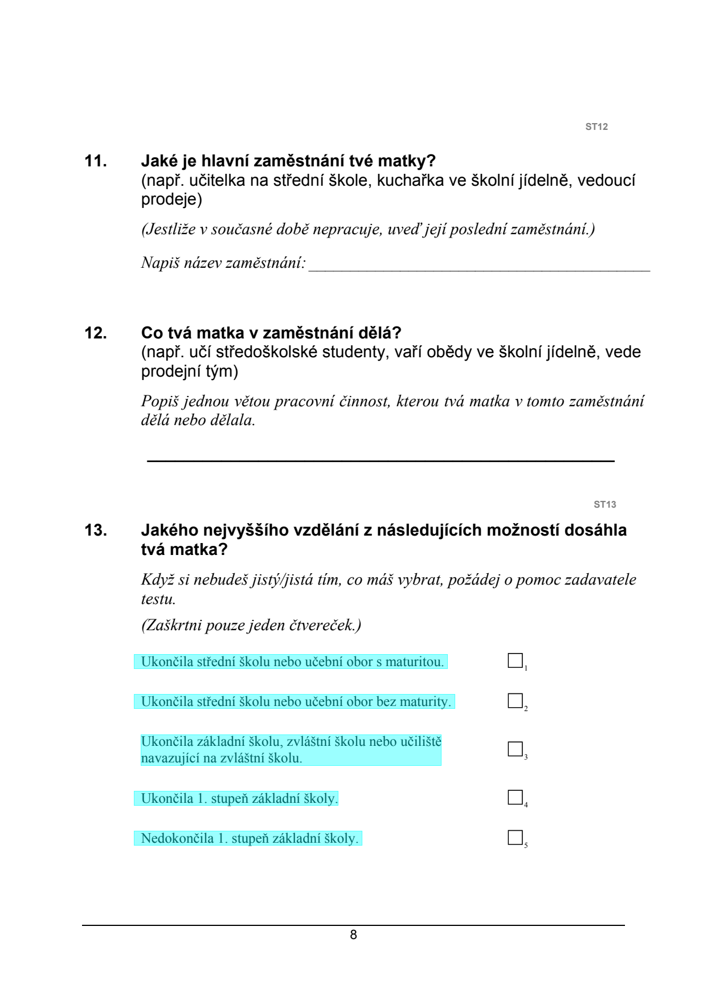

In [106]:
answer_areas[3].find_all('text:not(:italic):not-empty[size>8]').dissolve(padding=5).show()

In [55]:
results = []
for question, answer_area in zip(questions, answer_areas):
    result = {}
    result['question'] = question.extract_text()
    result['notes'] = (
        answer_area
        .find_all('text:italic:not-empty[size>8]')
        .extract_text()
    )
    result['answers'] = (
        answer_area
        .find_all('text:not(:italic):not-empty[size>8]')
        .extract_text()
    )
    results.append(result)
print("Found", len(results))

Found 17


In [57]:
import pandas as pd

df = pd.DataFrame(results)
df

,question,notes,answers
0,Kteří lidé obvykle bydlí u vás doma?,(V každém řádku zaškrtni pouze jeden čtvereček...,a) Matka (včetně nevlastní matky nebo pěstounk...
1,Jaké je hlavní zaměstnání tvé matky?,"(Jestliže v současné době nepracuje, uveď její...","(např. učitelka na střední škole, kuchařka ve ..."
2,Co tvá matka v zaměstnání dělá?,"Popiš jednou větou pracovní činnost, kterou tv...","(např. učí středoškolské studenty, vaří obědy ..."
3,Jakého nejvyššího vzdělání z následujících mož...,"Když si nebudeš jistý/jistá tím, co máš vybrat...",Ukončila střední školu nebo učební obor s matu...
4,Ukončila tvá matka některý z těchto typů pomat...,"Když si nebudeš jistý/jistá tím, co máš vybrat...",a) Získala na vysoké škole vědecký titul (Ph.D...
5,Co v současné době dělá tvá matka?,(Zaškrtni pouze jeden čtvereček.),Pracuje na plný úvazek. Pracuje na částečný ...
6,Jaké je hlavní zaměstnání tvého otce?,"(Jestliže v současné době nepracuje, uveď jeho...","(např. učitel na střední škole, truhlář, obcho..."
7,Co tvůj otec v zaměstnání dělá?,"Popiš jednou větou pracovní činnost, kterou tv...","(např. učí středoškolské studenty, vyrábí náby..."
8,Jakého nejvyššího vzdělání z následujících mož...,"Když si nebudeš jistý/jistá tím, co máš vybrat...",Ukončil střední školu nebo učební obor s matur...
9,Ukončil tvůj otec některý z těchto typů pomatu...,"Když si nebudeš jistý/jistá tím, co máš vybrat...",a) Získal na vysoké škole vědecký titul (Ph.D....


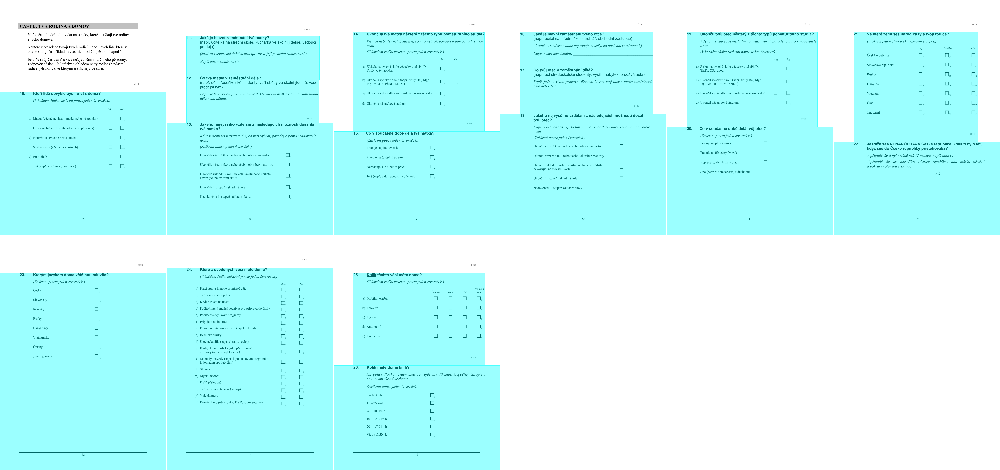

In [111]:
sections = (
    pdf
    .pages[6:15]
    .get_sections(
        start_elements='text:bold[size~=14]:regex(\d+)'
    )
)
sections.show()

In [67]:
print(sections[0].extract_text(layout=True))

          10.   Kteří lidé obvykle bydlí u vás doma?                              
                (V každém řádku zaškrtni pouze jeden čtvereček.)                  
                                                     Ano   Ne                     
              a) Matka (včetně nevlastní matky nebo pěstounky)                    
                                                        1    2                    
              b) Otec (včetně nevlastního otce nebo pěstouna)                     
                                                        1    2                    
              c) Bratr/bratři (včetně nevlastních)                                
                                                        1    2                    
              d) Sestra/sestry (včetně nevlastních)                               
                                                        1    2                    
              e) Prarodič/e                                                       
    

In [78]:
sections[0].find_all('text').inspect()

text,x0,top,x1,bottom,font_family,font_variant,size,bold,italic,strike,underline,highlight,source,confidence,color
10.,71,329,94,343,Arial,BCOMPD,14,True,False,False,False,True,native,1.00,#000000
Kte,119,329,141,343,Arial,BCOMPD,14,True,False,False,False,True,native,1.00,#000000
ř,141,329,147,343,Arial,BCOMPC,14,True,False,False,False,True,native,1.00,#000000
í lidé obvykle bydlí u vás doma?,147,329,365,343,Arial,BCOMPD,14,True,False,False,False,True,native,1.00,#000000
,71,354,74,368,Times,EPFLHA,14,False,True,False,False,True,native,1.00,#000000
(V každém,119,354,181,368,Times,EPFLHA,14,False,True,False,False,True,native,1.00,#000000
ř,181,354,186,368,Times,EPFLGP,14,False,True,False,False,True,native,1.00,#000000
ádku zaškrtni pouze jeden,186,354,335,368,Times,EPFLHA,14,False,True,False,False,True,native,1.00,#000000
č,335,354,341,368,Times,EPFLGP,14,False,True,False,False,True,native,1.00,#000000
tvere,341,354,369,368,Times,EPFLHA,14,False,True,False,False,True,native,1.00,#000000


In [94]:
question = sections[0].find_all('text:bold').extract_text()
print(question)

10. Kteří lidé obvykle bydlí u vás doma?


In [93]:
notes = sections[0].find_all('text:italic[size~=14]').extract_text()
print(notes)

(V každém řádku zaškrtni pouze jeden čtvereček.)


In [92]:
answers = sections[0].find_all('text:not(:bold):not(:italic)[size=12]').extract_text(layout=True, strip=True)
print(answers)

a) Matka (včetně nevlastní matky nebo pěstounky)
b) Otec (včetně nevlastního otce nebo pěstouna)
c) Bratr/bratři (včetně nevlastních)
d) Sestra/sestry (včetně nevlastních)
e) Prarodič/e
f) Jiní (např. sestřenice, bratranec)


In [100]:
results = []

for section in sections:
    question = section.find_all('text:bold').extract_text()
    notes = section.find_all('text:italic[size~=14]').extract_text()
    answers = section.find_all('text:not(:bold):not(:italic)[size=12]').extract_text(layout=True, strip=True)
    results.append({
        'question': question,
        'notes': notes,
        'answers': answers
    })
len(results)

17

In [101]:
import pandas as pd

df = pd.DataFrame(results)
df.head()

,question,notes,answers
0,10. Kteří lidé obvykle bydlí u vás doma?,(V každém řádku zaškrtni pouze jeden čtvereček.),a) Matka (včetně nevlastní matky nebo pěstounk...
1,11. Jaké je hlavní zaměstnání tvé matky? 1...,"(Jestliže v současné době nepracuje, uveď její...",
2,12. Co tvá matka v zaměstnání dělá? ST13 13....,"Popiš jednou větou pracovní činnost, kterou tv...",
3,13. Jakého nejvyššího vzdělání z následujících...,"Když si nebudeš jistý/jistá tím, co máš vybrat...",Ukončila střední školu nebo učební obor s matu...
4,14. Ukončila tvá matka některý z těchto typů p...,"Když si nebudeš jistý/jistá tím, co máš vybrat...",a) Získala na vysoké škole vědecký titul (Ph.D...
